# Objekterkennung von Gelenken auf dem Boneage Datensatz mit YOLOv5

Bei der Objekterkennung geht es darum, Objekte innerhalb eines Bildes zu finden und zu klassifizieren. Anders als bei der Segmentierung werden die Objekte dabei üblicherweise mit Bounding-Boxen umgeben, die alle Pixel des Objekts enthalten sollen, darüber hinaus aber auch Teile des Hintergrunds oder umgebender Objekte enthalten. In diesem Notebook soll ein Modell zur Objekterkennung für den Boneage Datensatz mit [YOLOv5](https://github.com/ultralytics/yolov5) und PyTorch als Backend trainiert werden. 

<img src="https://dds-lab.github.io/disaster-damage-detection/cvision.png" width="512"/>
Quelle: https://dds-lab.github.io/disaster-damage-detection/cvision.png


# 1. Datensatz

Der [Boneage](https://www.rsna.org/education/ai-resources-and-training/ai-image-challenge/rsna-pediatric-bone-age-challenge-2017) Datensatz besteht aus ingesamt 12.800 Hand-Röntgenaufnahmen von Kindern und Jugendlichen, die sich in 12.600 Trainings- und 200 Testbilder aufteilen. Ziel der RSNA-Challenge war die Altersbestimmung des zugehörigen Patienten aufgrund dieser Röntgenbilder.

Der für die Objekterkennung verwendete Datensatz ist ein [Subset](https://github.com/razorx89/rsna-boneage-ossification-roi-detection) des ursprünglichen Bonage-Datensatzes mit insgesamt 240 Trainings- und 89 Validierungsbildern und annotierten _Regions Of Interests_ (ROIs)/ Bounding-Boxen (BBox) für die Altersbestimmung relevanten Gelenke:
- distal interphalangeal joints (DIP, unten in grün)
- proximal interphalangeal joints (PIP, unten in türkis)
- metacarpophalangeal joints (MCP, unten in blass grün)
- Handgelenk
- Elle
- Speiche

<img src="https://raw.githubusercontent.com/razorx89/rsna-boneage-ossification-roi-detection/master/example.png" width="450" />

Für weitere Informationen sei auf das Paper [Ossification area localization in pediatric hand radiographs using deep neural networks for object detection](https://doi.org/10.1371/journal.pone.0207496) von S. Koitka, A. Demircioglu, M.S. Kim, C.M. Friedrich, F. Nensa verwiesen.

Das Ziel unseres Modells ist die Objektdetektion entsprechender Gelenke mit BBoxen sowie Klassifikation dieser Gelenke.

## Datensatz für YOLO vorbereiten
Der zuvor angegebene Datensatz stellt die annotierten BBoxen in verschiedenen Formaten bereit, entweder im "COCO/ Pascal VOC"-Format als einzelne XML-Dateien für jedes Bild oder zusammengefasst als CSV-Datei über das Skript `source/helper/xml_to_csv.py`. In diesem Beispiel verwenden wir die zusammengefassten BBoxen aus der CSV-Datei, die das folgende Format hat:

| filename | width | height | class | xmin | ymin | xmax | ymax |
| :-: | :-: | :-: | :-: | :-: | :-: | :-: | :-: |
|4200.png|880|1270|PIP|181|458|238|541|
|4200.png|880|1270|DIP|148|380|205|456|
|...|...|...|...|...|...|...|...|...|
|6499.png|1263|1995|Wrist|392|1034|846|1318|

Die Spalte `filename` verweist auf das zugrunde liegende Röntgenbild mit `width` als Bildbreite und `height` als Bildhöhe. Die Spalten `xmin, ymin, xmax, ymax` definieren die Eckpunkte einer Bounding Box (BBox) des Röntgenbildes mit `class` als Gelenkklasse. Pro Röntgenbild sind mehrere Bounding-Boxen (BBox) möglich.

### Das YOLO Format 
Das in der vorherigen Tabelle angegebene Format der Bounding-Boxen (xmin, ymin, xmax, ymax) ist nicht mit dem YOLOv5 Framework kompatibel, daher ist eine Kovertierung notwendig. Das YOLO-Format erfordert eine txt-Datei pro Bild mit selbem Dateinamen wie das Bild und den folgenden Angaben zu den Bounding-Boxen:
- Eine Zeile pro Objekt mit: Klasse x_center y_center width height (x,y_center = x, y-Zentrum der BBox; width, height = Breite und Höhe der BBox)
- Die Koordinaten der BBoxen müssen im normalisierten xywh-Format (0-1) vorliegen
- Die Klassennummern sind null-indiziert (beginnend bei 0)

Beipiel des YOLO Formates aus dem [GitHub-Repository](https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data#train-on-custom-data) von YOLOv5:
<table><tr>
<td> <img src=https://user-images.githubusercontent.com/26833433/91506361-c7965000-e886-11ea-8291-c72b98c25eec.jpg alt="Bild mit BBoxen" style="width: 300px;"/> </td>
<td> <img src=https://user-images.githubusercontent.com/26833433/112467037-d2568c00-8d66-11eb-8796-55402ac0d62f.png alt="BBox YOLO-Format" style="width: 350px;"/> </td>
</tr></table>

Außerdem erfordert das YOLOv5 Framework, zu jedem Datensatz eine YAML-Konfigurationsdatei `<dataset_name>.yaml` mit folgenden Angaben:
```
path: ../datasets/bonage_od  # dataset root dir
train: images/train  # relative path to train images
val: images/valid  # relative path to validation images
test:  # relative path to test images (optional)

# Classes
nc: 6 # number of classes
names: ['PIP', 'DIP', 'MCP', 'Wrist', 'Ulna', 'Radius'] # class names
```
Das Datensatzverzeichnis `/datasets/` sollte sich auf der gleichen Ebene wie das `/yolov5/`-Verzeichnis befindet. Da das YOLOv5 Framework für jedes Bild automatisch den Pfad zu den BBox-Dateien ermittelt, indem es `/images/` durch `/labels/` in jedem Bildpfad ersetzt, ist die folgende Ordnerstruktur sinnvoll:
```
/datasets/
└── dataset_root_path
    ├── images
    │   ├── train
    │   └── valid
    ├── labels
    │   ├── train
    │   └── valid
    └── dataset.yaml
```

### Datensatz ins YOLO-Format konvertieren
Das folgende Skript konvertiert die BBoxen der CSV-Datei des Boneage-Datensatzes in einen YOLOv5-kompatiblen Datensatz. 

__Schritt 1:__ Importieren der benötigten Packages und definieren der Konvertierungsmethoden.

In [ ]:
import os, shutil
import pandas as pd
import numpy as np

# returns a YOLO formatted bbox 
def to_yolo_format(bboxen, class_names):
    class_idx = class_names.index(bboxen['class'])
    
    # calculate normalized xywh coordinates of bbox 
    x_center = ((bboxen['xmin'] + bboxen['xmax']) / 2.0) / bboxen['width'] 
    y_center = ((bboxen['ymin'] + bboxen['ymax']) / 2.0) / bboxen['height'] 
    width = (bboxen['xmax'] - bboxen['xmin']) / bboxen['width'] 
    height = (bboxen['ymax'] - bboxen['ymin']) / bboxen['height'] 
    
    # merge to YOLO format
    yolo_format = f"{class_idx} {x_center:.6f} {y_center:.6f} {width:.6f} {height:.6f}"
    return yolo_format

__Schritt 2:__ Angabe der Quell- und Zielverzeichnisse. `IMAGE_FILES` enthält den Dateipfad zu den Röntgenbildern des Boneage-Datensatzes. `TRAIN_ROIS` und `VALID_ROIS` die Dateipfade zu den CSV-Dateien der annotierten BBoxen. `YOLO_DATASET_ROOT` das Hauptverzeichnis des YOLO-formatierten Datensatzes. Einlesen der CSV-Dateien mit den annotierten BBoxen als DataFrame und extrahieren der eindeutigen Klassennamen.

In [ ]:
IMAGE_FILES = "./datasets/BoneAge/boneage-training-dataset/"
TRAIN_BBOXEN = "./datasets/BoneAge/annotations/train/train_annotations.csv"
VALID_BBOXEN = "./datasets/BoneAge/annotations/eval/nonexpert/eval_nonexpert_annotations.csv"
YOLO_DATASET_ROOT = "./datasets/boneage_yolo/"

# load ROIs CSVs for training and validation images
train_bboxen = pd.read_csv(TRAIN_BBOXEN, header=0)
valid_bboxen = pd.read_csv(VALID_BBOXEN, header=0)

# extract unique class names
CLASS_NAMES = train_bboxen['class'].unique().tolist()

__Schritt 3:__ Konvertieren ins YOLO-Format.

In [ ]:
# select training or validation ROIs 
for split, rois in zip(["train", "valid"], [train_bboxen, valid_bboxen]):
    # create dataset structure if not exists
    os.makedirs(os.path.normpath(f"{YOLO_DATASET_ROOT}/images/{split}/"), exist_ok=True)
    os.makedirs(os.path.normpath(f"{YOLO_DATASET_ROOT}/labels/{split}/"), exist_ok=True)
    
    # iterate over each row of ROIs, convert and save it to YOLO format 
    for _, roi_row in rois.iterrows():
        yolo_format = to_yolo_format(roi_row, CLASS_NAMES) # convert roi_row into a yolo formatted bbox

        img_file = roi_row['filename'] # get image filename
        label_file = f"{img_file.split('.')[0]}.txt" # create yolo label filename as image filename
        
        # copy/overwrite the image file to the correct dataset directory
        shutil.copy(os.path.normpath(f"{IMAGE_FILES}/{img_file}"), os.path.normpath(f"{YOLO_DATASET_ROOT}/images/{split}/{img_file}"))

        # append yolo bbox to label file
        with open(os.path.normpath(f"{YOLO_DATASET_ROOT}/labels/{split}/{label_file}"), "a") as f:
            f.write(yolo_format + '\n')

__Schritt 4:__ YAML-Konfigurationsdatei des Datensatzes erstellen. 

In [ ]:
DATASET_YAML = (f"path: .{YOLO_DATASET_ROOT}  # dataset root dir\n"
                "train: images/train  # train images (relative to 'path')\n"
                "val: images/valid  # val images (relative to 'path')\n"
                "test:  # test images (optional)\n"
                "\n"
                "# Classes\n"
                f"nc: {len(CLASS_NAMES)} # number of classes\n"
                f"names: {CLASS_NAMES} # class names")

with open(os.path.normpath(f"{YOLO_DATASET_ROOT}/boneage_yolo.yaml"), "w") as f:
        f.write(DATASET_YAML)

# 2. YOLOv5 Framework herunterladen

Um das YOLOv5 Framework zu verwenden, muss es zunächst aus dem offiziellen [GitHub-Repository](https://github.com/ultralytics/yolov5) heruntergeladen und alle notwendigen Packages installiert werden. 

Über `!git clone <repo link>` wird das YOLOv5-Framework aus dem GitHub-Repository heruntergeladen.

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone yolo repo

Die zur Ausführung des YOLOv5-Frameworks erforderlichen Python Packages sind in der "requirements.txt" im yolov5-Verzeichnis aufgelistet.

Mit `%cd yolo5` kann in das yolov5-Verzeichnis gewechselt werden und mit`!pip install -r requirements.txt` die Packages nachinstalliert werden. Danach muss der Kernel neu gestartet werden!

In [ ]:
%cd yolov5
!pip install -r requirements.txt # install required packages

# 3. YOLOv5-Modell Training
Mit `!python train.py` kann das Trainingsskirpt des YOLOv5 Frameworks aufgerufen werden. Hier sind einige Parameter zu definieren.
- `--img`: Festlegen der Bildgröße
- `--batch`: Batch-Größe (Bitte nicht verändern, da GPU-Ressourcen zwischen Usern geteilt werden)
- `--epochs`: Anzahl der Trainingsepochen
- `--data`: Pfad zur YAML-Konfigurationsdatei des Datensatzes
- `--weights:` Pfad zu vortrainierten Modellgewichten (siehe Bild für unterschiedliche Modellgrößen)
- `--hyp`: Pfad zur YAML-Konfigurationsdatei mit zusätzlichen Trainingshyperparametern
- weitere Parameter möglich, siehe [GitHub-Repository](https://github.com/ultralytics/yolov5) für Details

Sämtliche Trainingsergebnisse werden im `yolov5/runs/train/` Verzeichnis in aufsteigenden `exp`-Ordnern gespeichert, wie z.B. `yolov5/runs/train/exp2`, `yolov5/runs/train/exp3` usw. 

<img src="https://github.com/ultralytics/yolov5/releases/download/v1.0/model_comparison.png" width="450" />

In [6]:
dataset = "./datasets/boneage_yolo/"
!python train.py --img 640 --batch 24 --epochs 60 --data $dataset/boneage_yolo.yaml --weights yolov5s.pt

train: weights=yolov5s.pt, cfg=, data=../../datashare/boneage_yolo/boneage_yolo.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=60, batch_size=24, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: skipping check (Docker image), for updates see https://github.com/ultralytics/yolov5
YOLOv5 🚀 v6.1-258-g1156a32 Python-3.8.12 torch-1.11.0 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, a

# 4. Modell Evaluierung
Mit `!python val.py` kann das Validierungsskript des YOLOv5 Frameworks aufgerufen werden. Wie beim Training gibt es auch hier einige Parameter zu definieren:
- `--img`: Festlegen der Bildgröße, für die das Modell zuvor trainiert wurde
- `--batch`: Validierungs-Batch-Größe (Bitte nicht verändern, da GPU-Ressourcen zwischen Usern geteilt werden)
- `--iou-thres`: Schwellenwert der IoU für None-Max-Suppression (zum Herausfiltern möglicher überlappender Bounding-Boxen).
- `--data`: Pfad zur YAML-Konfigurationsdatei des Validierungsdatensatzes
- `--weights:` Pfad zu den zuvor trainierten Modellgewichten 
- weitere Parameter möglich, siehe [GitHub-Repository](https://github.com/ultralytics/yolov5) für Details

Sämtliche Validierungsergebnisse werden im `yolov5/runs/val/` Verzeichnis in aufsteigenden `exp`-Ordnern gespeichert, wie z.B. `yolov5/runs/val/exp2`, `yolov5/runs/val/exp3` usw. 

In [7]:
dataset = "./datasets/boneage_yolo/"
model_weights = "./runs/train/exp/weights/best.pt" # set path to trained model weights
!python val.py --img 640 --batch 24 --iou-thres 0.6 --data $dataset/boneage_yolo.yaml --weights $model_weights

val: data=../../datashare/boneage_yolo/boneage_yolo.yaml, weights=['./runs/train/exp/weights/best.pt'], batch_size=24, imgsz=640, conf_thres=0.001, iou_thres=0.6, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v6.1-258-g1156a32 Python-3.8.12 torch-1.11.0 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

Fusing layers... 
Model summary: 213 layers, 7026307 parameters, 0 gradients
val: Scanning '/datashare/boneage_yolo/labels/valid' images and labels...89 foun
val: WARNING: Cache directory /datashare/boneage_yolo/labels is not writeable: [Errno 13] Permission denied: '/datashare/boneage_yolo/labels/valid.cache.npy'
               Class     Images     Labels          P          R     mAP@.5 mAP@
                 all         89       1513      0.987      0.981       0.98      0.511
                 PIP         89        445   

# 5. Visualisierung
Im Folgenden werden einige Bilder der Validierungsdaten für die Inferenz ausgewählt und die Vorhersagen des YOLOv5-Modells visualisiert.

__Schritt 1:__ Import benötigter Packages

In [8]:
# %cd yolov5 # switch to the yolo directory in case of import erros 
import glob, torch
import pandas as pd
from PIL import Image

__Schritt 2:__ Laden des trainierten YOLOv5-Modells. Die Variable `model_weights` definiert den Pfad zu den trainierten Modellgewichten.

In [9]:
model_weights = "./runs/train/exp/weights/best.pt" # set path to trained model weights
model = torch.hub.load('ultralytics/yolov5', 'custom', path=model_weights) # load model

Using cache found in //home/user01/.cache/torch/hub/ultralytics_yolov5_master
YOLOv5 🚀 2022-6-18 Python-3.8.12 torch-1.11.0 CUDA:0 (Tesla V100-SXM2-16GB, 16160MiB)

Fusing layers... 
Model summary: 213 layers, 7026307 parameters, 0 gradients
Adding AutoShape... 


__Schritt 3:__ Laden einiger Bilder des Validierungsdatensatzes. Der Parameter `N` kann verwendet werden, um die Anzahl der Validierungsbilder festzulegen.

In [10]:
# load list of images of image file names
def load_images(image_files: list):
    return [Image.open(file).convert("RGB") for file in image_files]

N = 9 # number of visualized images
IMAGES = "./datasets/boneage_yolo/images/valid/" # path to validation image files
img_files = sorted(glob.glob(IMAGES + '*.png'))[:N] # get fist N image filenames
imgs = load_images(img_files) # load images to list

__Schritt 4:__ Inferenz mit den ausgewählten Validierungsbildern. Zunächst werden jedoch einige Parameter für die minimale Vorhersagekonfidenz sowie IoU, um mögliche überlappende Bounding Boxes herauszufiltern, festgelegt. Anschließend erfolgt die Inferenz durch iterative Übergabe der Bilder an das Modell und die Ausgabe/Visualisierung der Modellvorhersage. Für weitere Details siehe https://github.com/ultralytics/yolov5/issues/36

image 1/1: 1200x905 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 7.8ms pre-process, 66.5ms inference, 2.6ms NMS per image at shape (1, 3, 640, 512)
      xmin    ymin    xmax    ymax  confidence  class    name
0  597.322 214.671 652.974 285.663       0.880      1     DIP
1  578.413 301.384 641.046 375.887       0.856      0     PIP
2  321.445 231.084 376.461 301.122       0.853      1     DIP
3  368.244 724.035 646.245 915.776       0.848      3   Wrist
4  332.499 329.634 395.366 407.505       0.843      0     PIP
5  671.785 591.660 753.842 680.982       0.840      2     MCP
6  757.614 499.740 824.029 577.426       0.828      0     PIP
7  277.149 554.312 356.682 639.541       0.825      2     MCP
8  447.559 171.696 506.455 247.921       0.825      1     DIP
9  448.708 277.904 512.602 357.911       0.821      0     PIP
10 432.076 465.308 507.772 553.872       0.818      2     MCP
11 355.133 504.234 427.463 587.211       0.817      2     MCP
12 198.483 463.963 252.466 534.379

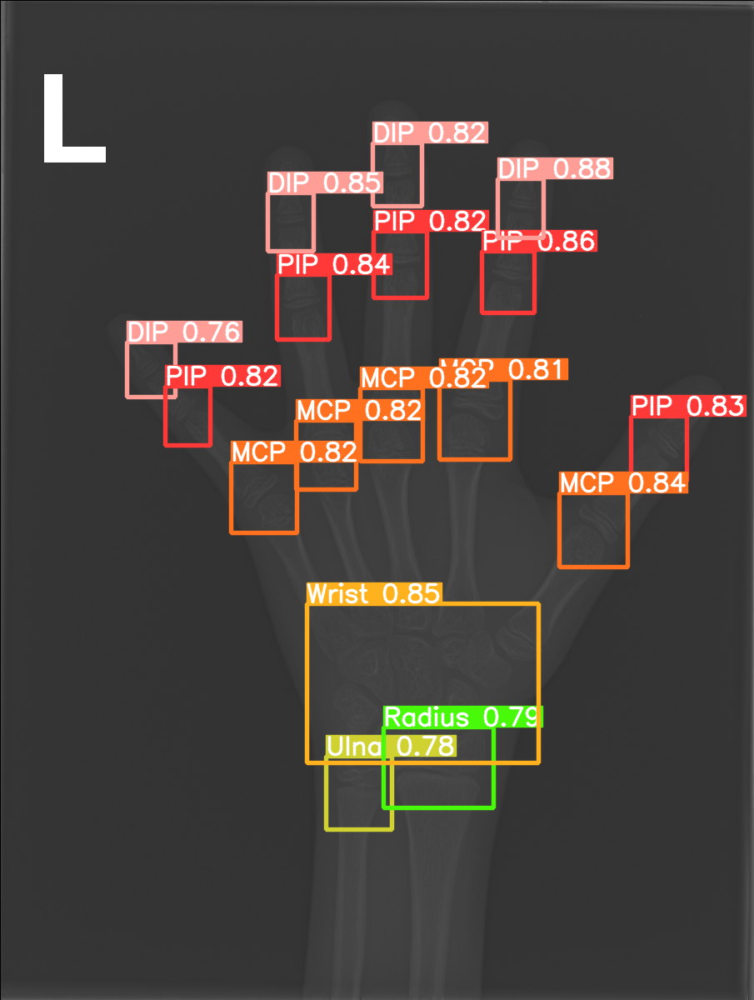

image 1/1: 1501x1426 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 11.3ms pre-process, 17.2ms inference, 1.8ms NMS per image at shape (1, 3, 640, 640)
       xmin     ymin     xmax     ymax  confidence  class    name
0   271.411  448.613  344.629  541.736       0.866      1     DIP
1   460.775  283.730  531.878  373.785       0.852      1     DIP
2   814.517  257.875  889.844  352.003       0.850      1     DIP
3   702.455  581.582  807.049  705.042       0.841      2     MCP
4   461.474  641.497  568.757  760.826       0.840      2     MCP
5   566.238  585.950  676.048  711.801       0.835      2     MCP
6   914.206  823.446 1025.201  935.634       0.829      2     MCP
7   459.334  422.455  543.249  524.366       0.823      0     PIP
8   357.137  719.171  452.557  838.694       0.823      2     MCP
9   606.808  213.227  683.645  310.789       0.820      1     DIP
10  598.094  351.900  681.309  462.634       0.815      0     PIP
11  452.279  940.443  848.646 1197.010       0

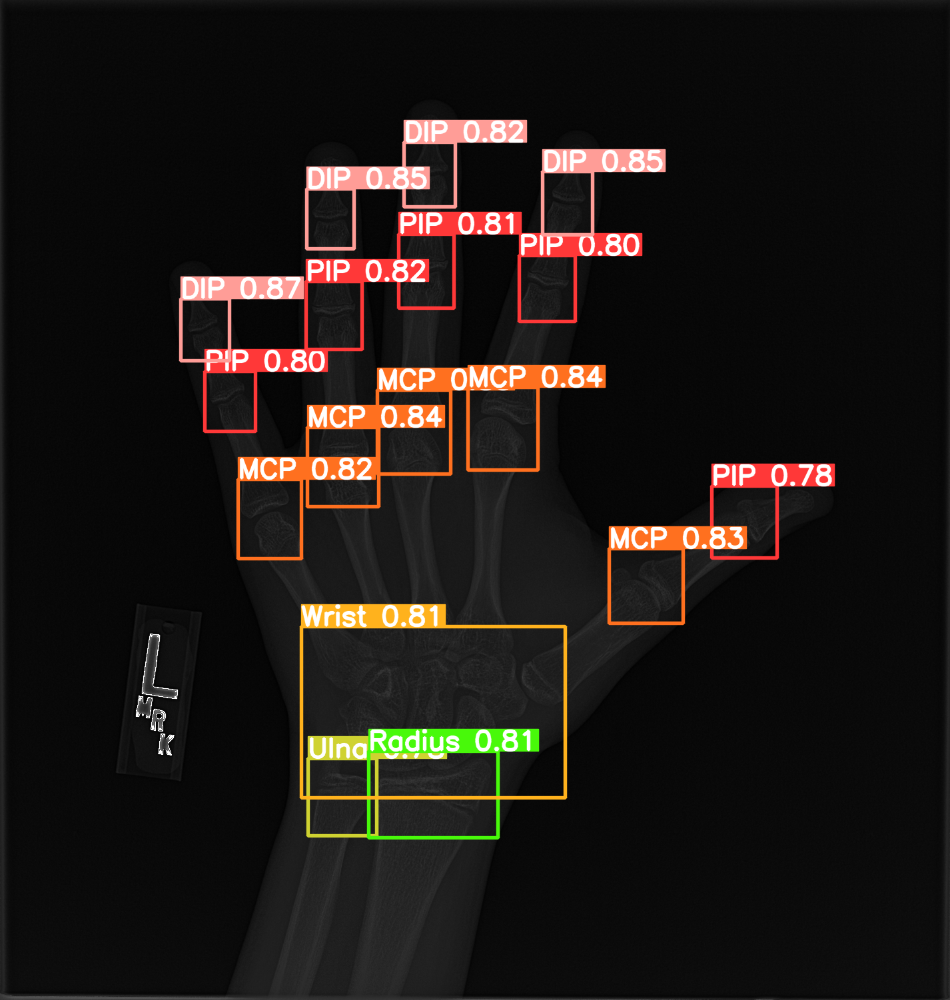

image 1/1: 1644x1460 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 7.9ms pre-process, 16.8ms inference, 1.8ms NMS per image at shape (1, 3, 640, 576)
       xmin     ymin     xmax     ymax  confidence  class    name
0   661.954 1324.613  902.898 1493.956       0.860      5  Radius
1   519.112 1101.781  997.532 1415.648       0.845      3   Wrist
2   563.667  742.530  673.460  889.816       0.834      2     MCP
3  1180.126  744.512 1291.713  883.103       0.822      0     PIP
4   686.220  687.461  818.750  845.630       0.822      2     MCP
5   430.914  814.462  562.384  972.864       0.821      2     MCP
6  1040.734  898.441 1174.797 1041.840       0.821      2     MCP
7   855.603  694.977  997.118  867.570       0.820      2     MCP
8   692.710  385.039  793.127  522.119       0.809      0     PIP
9   857.416  442.986  977.584  571.222       0.807      0     PIP
10  536.785  463.186  635.931  598.541       0.801      0     PIP
11  532.538  302.438  621.633  409.859       0.

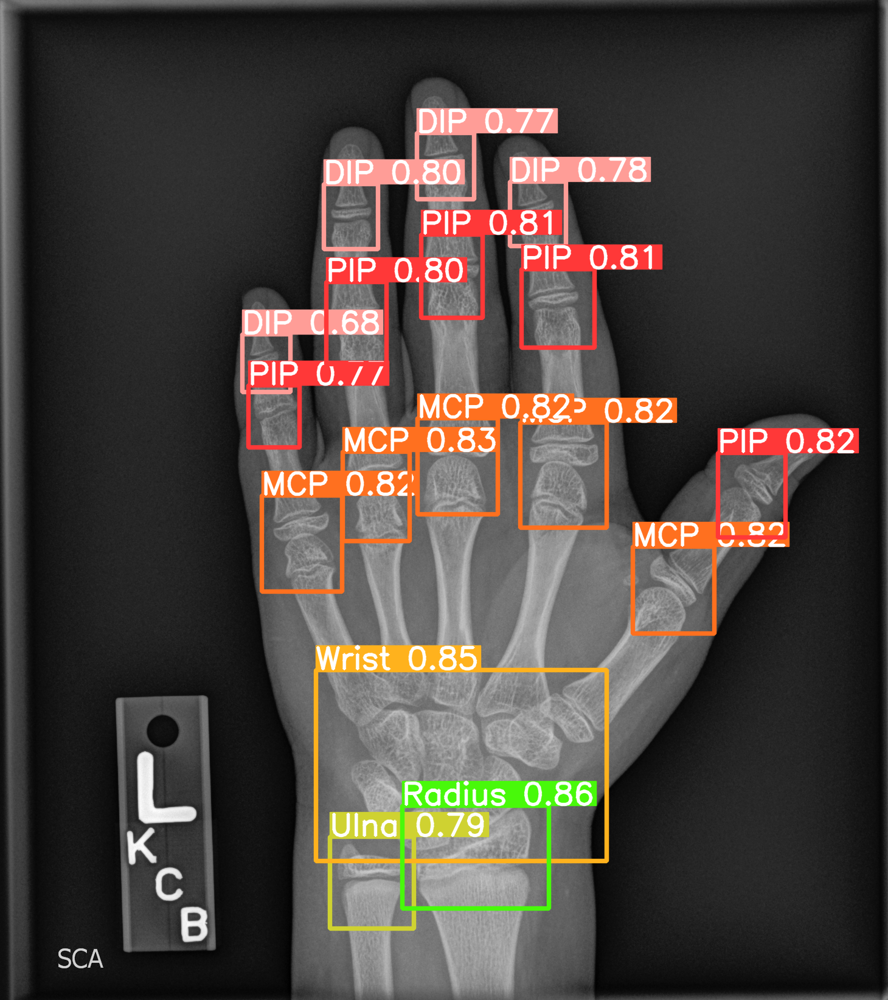

image 1/1: 2920x2320 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 28.0ms pre-process, 12.1ms inference, 1.8ms NMS per image at shape (1, 3, 640, 512)
       xmin     ymin     xmax     ymax  confidence  class    name
0   932.222 1258.840 1069.095 1427.695       0.854      2     MCP
1  1069.555 1207.031 1211.609 1385.881       0.824      2     MCP
2   842.972  753.237  938.693  881.996       0.823      1     DIP
3   914.553 1659.307 1357.269 1989.866       0.820      3   Wrist
4   864.900  938.095  989.246 1091.853       0.811      0     PIP
5  1663.360 1315.765 1783.568 1464.014       0.811      0     PIP
6   795.114 1313.254  941.789 1482.766       0.806      2     MCP
7  1487.499 1474.620 1635.971 1624.308       0.804      2     MCP
8  1066.786  867.615 1181.983 1023.965       0.800      0     PIP
9  1218.590 1226.918 1370.145 1405.302       0.793      2     MCP
10 1333.086  938.955 1444.957 1084.363       0.792      0     PIP
11 1071.761  678.090 1172.273  812.375       0

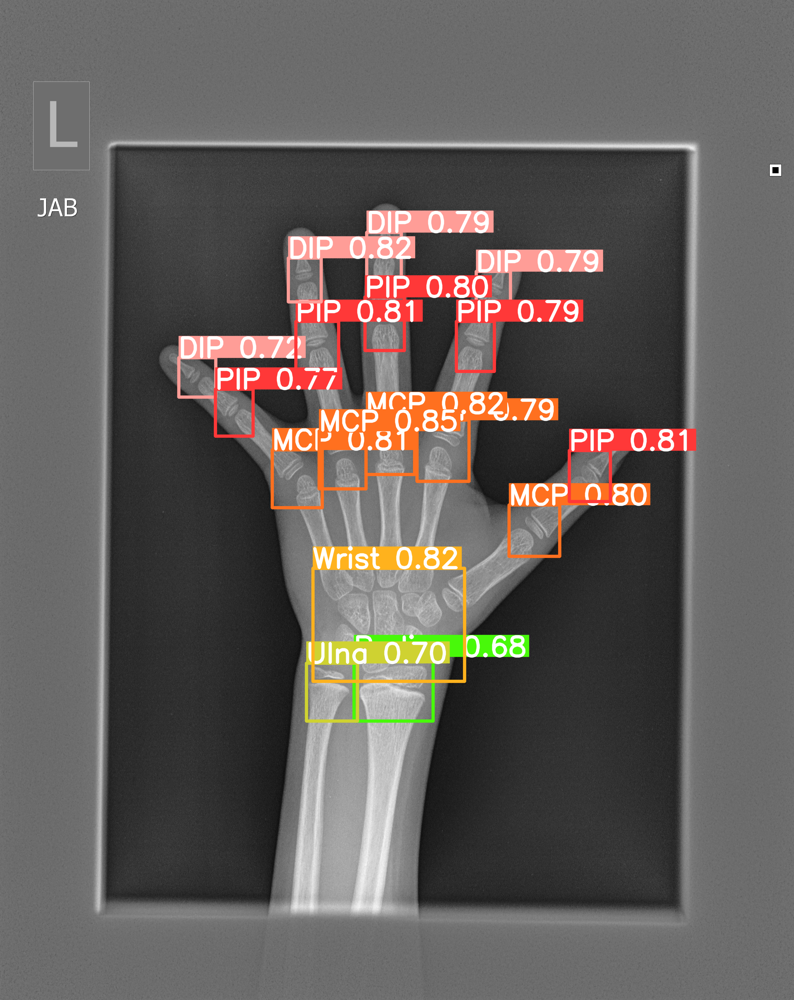

image 1/1: 972x723 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 4.0ms pre-process, 16.9ms inference, 1.8ms NMS per image at shape (1, 3, 640, 480)
      xmin    ymin    xmax    ymax  confidence  class    name
0  245.204 594.852 469.535 767.316       0.855      3   Wrist
1  444.826 336.692 501.780 404.149       0.828      0     PIP
2  402.624 449.448 477.765 538.783       0.826      2     MCP
3  215.553 459.635 287.035 543.914       0.825      2     MCP
4  362.003 303.684 417.855 372.938       0.818      0     PIP
5  334.947 453.373 394.936 527.409       0.808      2     MCP
6  281.087 321.924 331.138 386.521       0.802      0     PIP
7  241.347 744.249 310.787 820.514       0.802      4    Ulna
8  207.330 376.115 253.337 433.181       0.793      0     PIP
9  389.198 234.235 439.050 293.264       0.781      1     DIP
10 292.918 249.610 340.229 305.147       0.780      1     DIP
11 477.735 278.116 526.850 335.976       0.774      1     DIP
12 529.932 488.457 582.920 555.780 

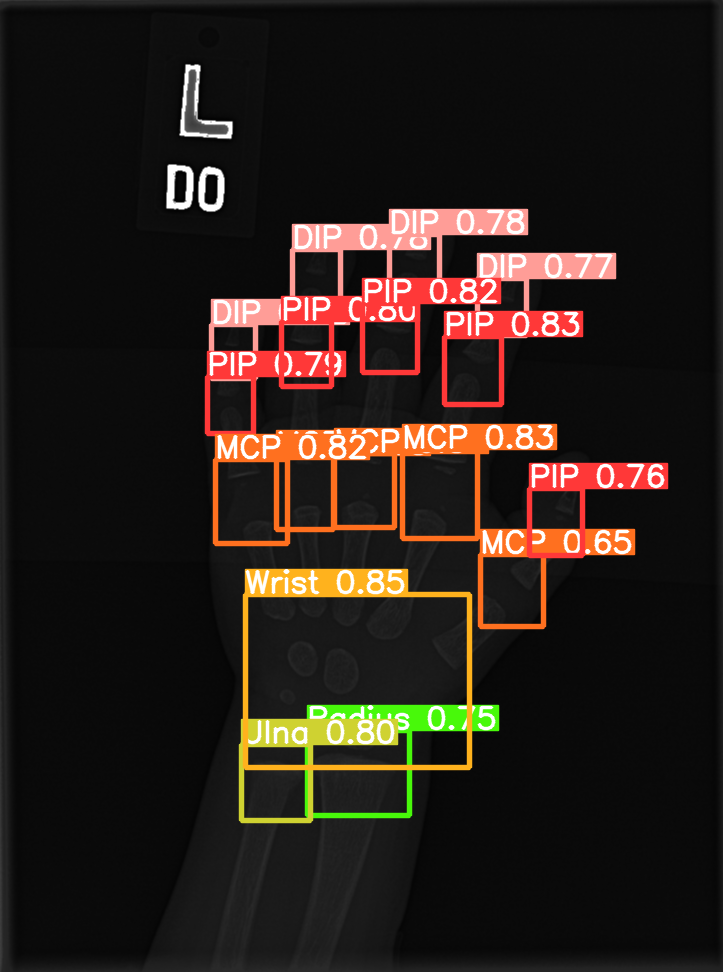

image 1/1: 1247x924 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 7.2ms pre-process, 11.6ms inference, 1.9ms NMS per image at shape (1, 3, 640, 480)
      xmin    ymin    xmax     ymax  confidence  class    name
0  285.276 218.318 345.761  295.235       0.875      1     DIP
1  556.428 186.950 619.228  265.797       0.870      1     DIP
2  732.615 499.222 805.955  583.044       0.862      0     PIP
3  314.598 719.339 632.715  940.823       0.861      3   Wrist
4  500.583 450.409 585.365  551.011       0.842      2     MCP
5  245.960 551.494 326.266  643.237       0.840      2     MCP
6  296.596 329.669 364.427  412.815       0.840      0     PIP
7  188.009 436.329 246.395  510.001       0.839      0     PIP
8  402.605 458.757 479.738  551.395       0.838      2     MCP
9  319.595 500.437 400.057  595.607       0.834      2     MCP
10 650.003 596.726 729.204  681.262       0.829      2     MCP
11 412.676 263.625 485.375  351.375       0.825      0     PIP
12 150.753 358.483 20

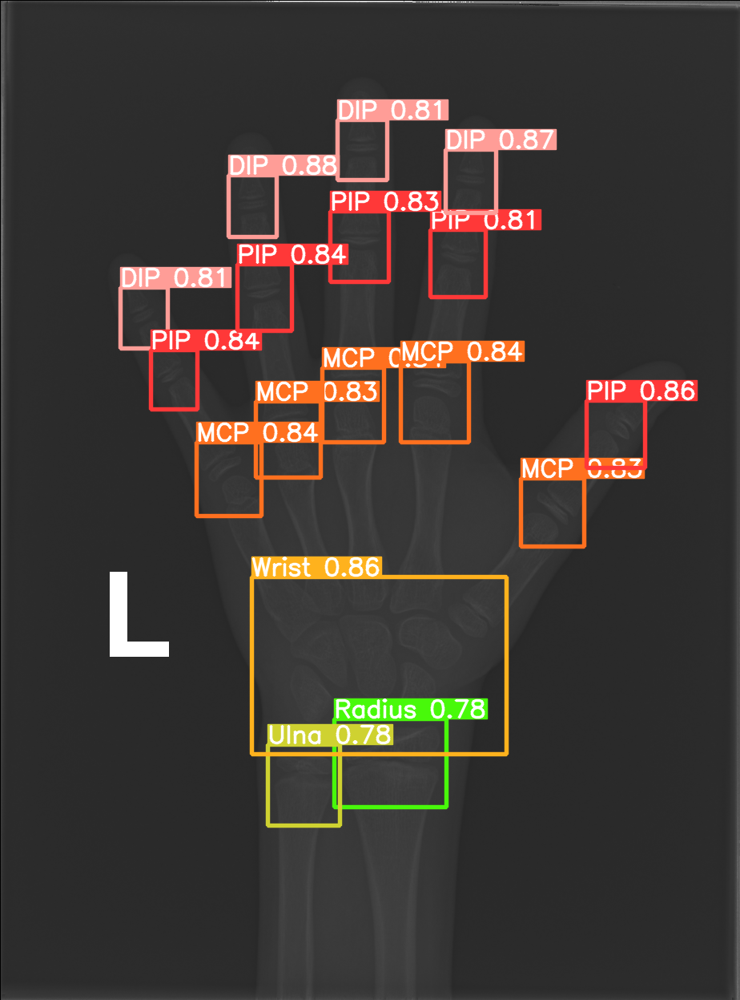

image 1/1: 969x1152 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 5.2ms pre-process, 15.7ms inference, 1.9ms NMS per image at shape (1, 3, 544, 640)
      xmin    ymin    xmax    ymax  confidence  class    name
0  741.953 223.455 798.882 294.882       0.851      0     PIP
1  663.998 354.004 726.109 428.648       0.841      2     MCP
2  571.097 248.459 628.137 320.286       0.839      0     PIP
3  546.626 407.843 611.674 478.501       0.839      2     MCP
4  587.715 520.170 822.462 691.220       0.838      3   Wrist
5  558.581 175.228 607.874 237.835       0.834      1     DIP
6  732.237 348.042 798.511 427.219       0.831      2     MCP
7  664.075 141.586 713.247 204.210       0.831      1     DIP
8  603.026 375.705 660.522 446.150       0.829      2     MCP
9  846.602 462.191 911.812 535.231       0.824      2     MCP
10 507.876 319.474 556.345 380.425       0.800      0     PIP
11 737.638 155.319 787.977 219.241       0.794      1     DIP
12 493.683 263.659 538.832 322.968

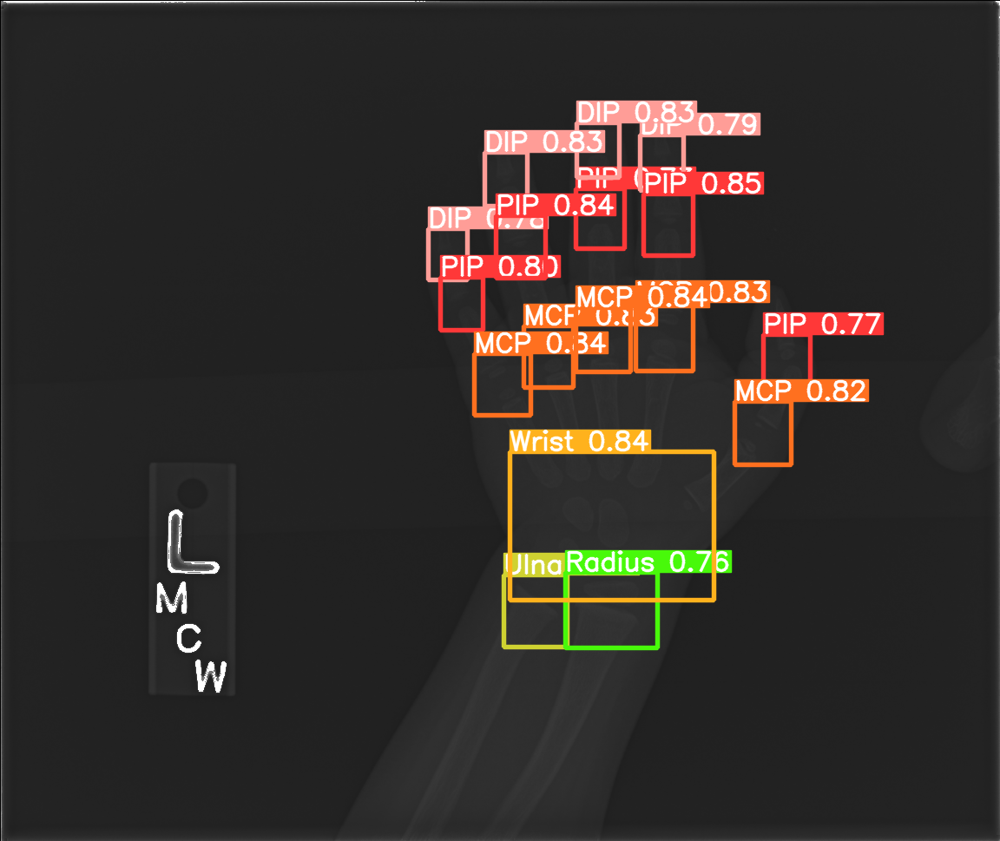

image 1/1: 2920x2320 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 37.7ms pre-process, 11.9ms inference, 1.7ms NMS per image at shape (1, 3, 640, 512)
       xmin     ymin     xmax     ymax  confidence  class    name
0   792.819 1766.742 1516.833 2230.785       0.856      3   Wrist
1  1010.403 1120.382 1195.286 1330.680       0.841      2     MCP
2   640.354 1355.243  814.941 1551.498       0.835      2     MCP
3   821.641 1214.128  997.518 1411.261       0.833      2     MCP
4  1018.755 2093.035 1374.215 2338.927       0.831      5  Radius
5  1065.850  400.658 1202.544  579.447       0.830      1     DIP
6  1443.128  470.748 1580.685  644.935       0.827      1     DIP
7  1592.491 1526.272 1789.216 1719.863       0.824      2     MCP
8   757.282  559.389  881.239  714.835       0.819      1     DIP
9   778.663  805.949  921.727  984.109       0.818      0     PIP
10 1248.708 1101.319 1455.627 1337.945       0.817      2     MCP
11 1757.466 1259.283 1902.257 1443.282       0

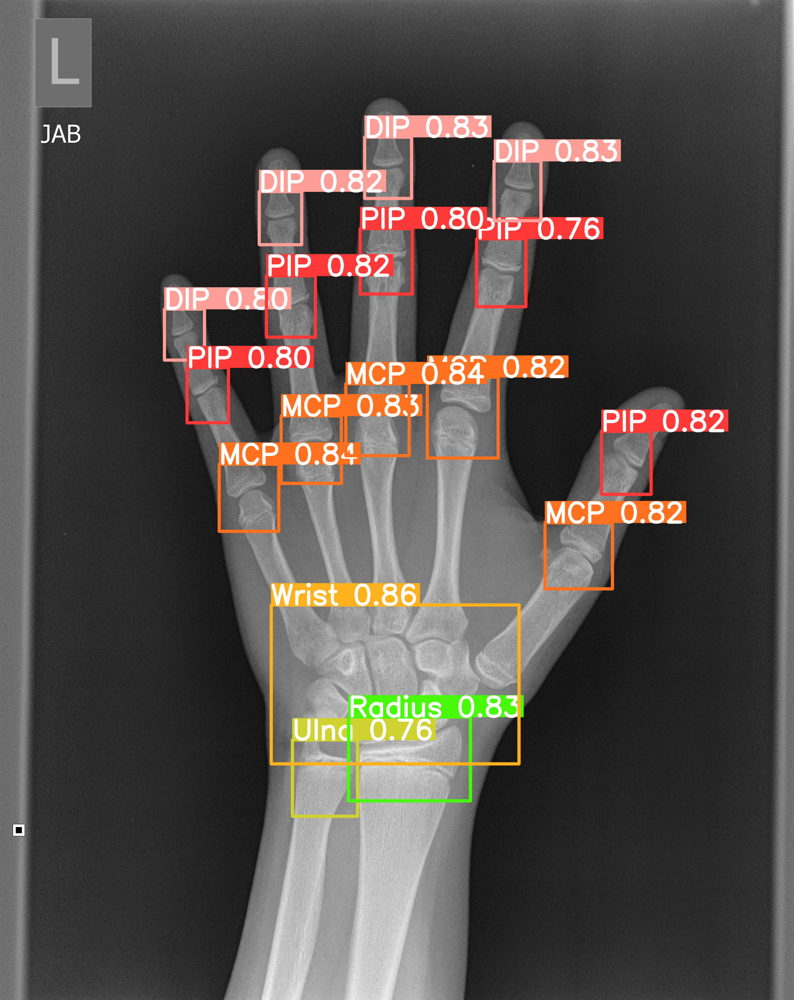

image 1/1: 1285x887 5 PIPs, 4 DIPs, 5 MCPs, 1 Wrist, 1 Ulna, 1 Radius
Speed: 4.8ms pre-process, 15.9ms inference, 1.7ms NMS per image at shape (1, 3, 640, 448)
      xmin    ymin    xmax     ymax  confidence  class    name
0  518.165 534.240 584.602  620.325       0.836      2     MCP
1  339.368 757.437 603.898  949.698       0.833      3   Wrist
2  451.895 488.811 524.895  578.305       0.830      2     MCP
3  360.383 479.965 441.731  575.048       0.830      2     MCP
4  391.981 893.838 525.283  991.326       0.825      5  Radius
5  575.664 564.475 643.134  645.967       0.822      2     MCP
6  561.016 372.524 622.583  448.425       0.821      0     PIP
7  164.417 557.674 232.593  641.105       0.816      0     PIP
8  329.130 314.216 391.278  392.016       0.812      0     PIP
9  214.213 684.479 289.785  763.873       0.810      2     MCP
10 442.183 302.540 509.331  379.161       0.808      0     PIP
11 583.609 266.958 641.513  338.664       0.806      1     DIP
12 660.049 471.044 71

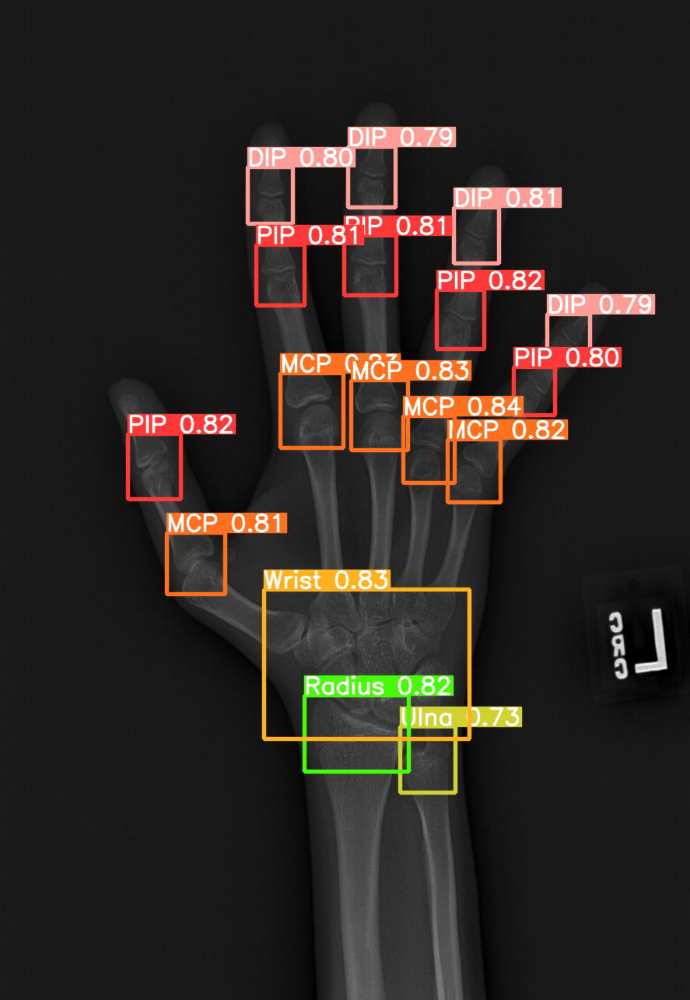

In [11]:
# Inference settings
model.conf = 0.6 # min. confidence of 0.6
model.iou = 0.6 # min IoU of 0.6 for none-max-suppression (filtering of overlapping bboxes)

# iterate over images
for i, img in enumerate(imgs):
    result = model(img, size=640) # nms inference for single image
    result.print() # print inference results
    with pd.option_context('display.float_format', '{:0.3f}'.format): # print coordinates of bboxes 
        print(result.pandas().xyxy[0]) 
    result.show() # show inference results